<a href="https://colab.research.google.com/github/charissaabegail/guidewiredetection/blob/main/nb_data_prep.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!ls

drive  sample_data


In [ ]:
cd drive

/content/drive


In [ ]:
!ls

MyDrive


In [ ]:
cd MyDrive/Colab\ Notebooks

/content/drive/MyDrive/Colab Notebooks


In [ ]:
!ls

 Activity1
'Copy of colab_webcam.ipynb'
'Copy of yolov4_webcam.ipynb'
 nb_data_prep.ipynb
 object_detection_basics.ipynb
 Untitled0.ipynb
 Untitled1.ipynb
 yolo-object-detection-custom
'YOLO Object Detection on Custom Data-UDEMY.ipynb'


In [ ]:
cd yolo-object-detection-custom/

/content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom


In [ ]:
!rm data/data-aurora.zip

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import shutil
shutil.rmtree("data/data-aurora.zip", ignore_errors=True)

In [ ]:
!ls

drive  sample_data


In [ ]:
cd drive/MyDrive

/content/drive/MyDrive


In [2]:
cd /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom


/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom


In [ ]:
!ls

data


In [ ]:
cd yolo-object-detection-custom/data/labelled/labelled-data

/content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled-data


In [2]:





cd /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/processed/

/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/processed


In [3]:
!unzip data-aurora.zip

Archive:  data-aurora.zip
   creating: data-aurora/
  inflating: __MACOSX/._data-aurora  
   creating: data-aurora/pos6/
   creating: data-aurora/pos1/
   creating: data-aurora/pos8/
  inflating: data-aurora/.DS_Store   
  inflating: __MACOSX/data-aurora/._.DS_Store  
   creating: data-aurora/pos12/
   creating: data-aurora/pos9/
   creating: data-aurora/pos7/
   creating: data-aurora/Camera Roll/
   creating: data-aurora/pos11/
   creating: data-aurora/pos2/
   creating: data-aurora/pos5/
   creating: data-aurora/pos10/
   creating: data-aurora/pos4/
   creating: data-aurora/pos3/
  inflating: data-aurora/pos6/capture_60.png  
  inflating: data-aurora/pos6/capture_23.json  
  inflating: data-aurora/pos6/capture_74.png  
  inflating: data-aurora/pos6/capture_48.png  
  inflating: data-aurora/pos6/capture_74.json  
  inflating: data-aurora/pos6/capture_62.json  
  inflating: data-aurora/pos6/capture_35.json  
  inflating: data-aurora/pos6/capture_19.json  
  inflating: data-aurora/pos6/

In [ ]:
!ls

data-aurora  data-aurora-old.zip  data-aurora.zip  __MACOSX


In [ ]:
!rm data-aurora.zip

In [ ]:
!ls

external  interim  __MACOSX  processed	raw


In [ ]:
cd ..

/content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom


In [ ]:
!ls

data  models	 references  requirements.txt  src
docs  notebooks  reports     setup.py


In [ ]:
!python src/data/data_prep.py

Hello World! You are running data_prep.py


In [4]:
# augmentation pipeline
# Rotations -> color change -> (Augmentation principle include in the documentation)

# make sure that data is properly labeled - YOLO format
# read the folder
# augmentation pipeline


!ls

darknet  docs	 notebooks	   references  requirements.txt  src
data	 models  output_image.png  reports     setup.py


In [ ]:
#/content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom
cd drive/MyDrive/Colab \Notebooks/yolo-object-detection-custom/

SyntaxError: ignored

In [ ]:
!ls

# **Data Viewing**

capture_8.json
capture_14.json
capture_2.png
capture_1.png
capture_9.json
capture_4.png
capture_4.json
capture_17.png
capture_6.png
capture_7.png
capture_13.png
capture_11.png
capture_13.json
capture_10.json
capture_16.png
capture_11.json
capture_14.png
capture_15.png
capture_10.png
capture_3.json
capture_3.png
capture_15.json
capture_5.png
capture_12.png
capture_7.json
capture_1.json
capture_5.json
capture_9.png
capture_8.png
capture_6.json
capture_12.json
capture_17.json
capture_2.json
capture_16.json
capture_27.png
capture_29.json
capture_34.png
capture_29.png
capture_18.json
capture_23.png
capture_24.png
capture_26.png
capture_35.json
capture_25.png
capture_22.json
capture_18.png
capture_25.json
capture_31.json
capture_19.png
capture_24.json
capture_21.json
capture_28.png
capture_30.png
capture_31.png
capture_22.png
capture_23.json
capture_26.json
capture_30.json
capture_28.json
capture_20.png
capture_19.json
capture_34.json
capture_27.json
capture_32.png
capture_35.png
capture_21.

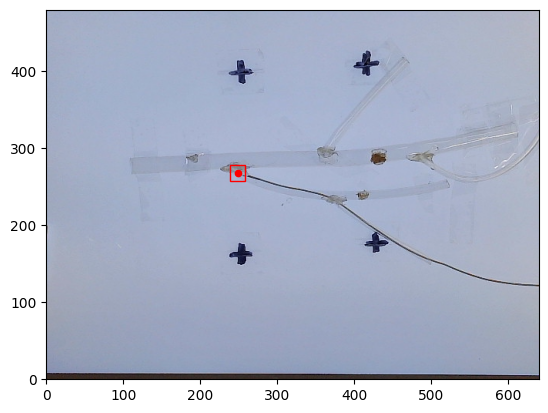

In [12]:
import os
import re
import json
from PIL import Image, ImageDraw

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import numpy as np

import matplotlib.patches as patches
import pandas as pd
from matplotlib.patches import Rectangle

# Define a custom sorting key function
def get_capture_number(filename):
    print(filename)
    # Split the filename by "_" and get the last part as a string
    capture_part = filename.split("_")[-1]
    # Remove any file extensions (e.g., ".png" or ".json") and convert to an integer
    return int(capture_part.split(".")[0])

# Calculate bounding box - Defining region for the tip
def calculate_bounding_box(center_x, center_y, width, height):
  x_min = center_x - (width / 2)
  y_min = center_y - (height / 2)
  x_max = center_x - (width / 2)
  y_max = center_y - (height / 2)
  return x_min, y_min, x_max, y_max

# normalized bounding box center
def normalize_coords(x_shifted, y_shifted, img, bbox_h, bbox_w):
  height, width, channels = img.shape
  x_norm = x_shifted / width
  y_norm = y_shifted / height
  h_norm = bbox_h / height
  w_norm = bbox_w / width
  return x_norm, y_norm, h_norm, w_norm


# Specify the directory path where your JSON files are located
directory_path = '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/processed/data-aurora/pos6'
# directory_path = '/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/processed/data_aurora/'

# Initialize an empty list to store the JSON data from each file
json_data_list = []
file_list = os.listdir(directory_path)
# print(file_list)
# file_list = [os.path.join(directory_path, filename) for filename in os.listdir(directory_path)]
# file_list = sorted(filter(os.path.isfile, os.listdir(directory_path)), key=os.path.getmtime)
file_list = sorted(file_list, key=get_capture_number)

# Iterate over the files in the directory
for filename in file_list:
    basename, ext = os.path.splitext(filename)

    file_path = os.path.join(directory_path, basename+".json")
    with open(file_path, 'r') as json_file:
      json_data = json.load(json_file)
      val_toolName = json_data[0]["toolName"]
      x_shifted = json_data[0]["x_shifted"]
      y_shifted = json_data[0]["y_shifted"]
      z_shifted = json_data[0]["z_shifted"]

      x_raw = json_data[0]["x_raw"]
      y_raw = json_data[0]["y_raw"]
      z_raw = json_data[0]["z_raw"]

    image_path = os.path.join(directory_path, basename+".png")
    print(image_path)
    img = plt.imread(image_path)

    # # Convert the image to floating-point format
    # image_float = img.astype(np.float32)
    # # Find the minimum and maximum pixel values
    # min_pixel_value = np.min(image_float)
    # max_pixel_value = np.max(image_float)

    # img_norm = (image_float - min_pixel_value) / (max_pixel_value - min_pixel_value)

    fig, ax = plt.subplots()
    # ax.set_xlim(0, 1)
    # ax.set_ylim(0, 1)
    # # Display the image
    ax.imshow(img)

    # Plot the red point
    ax.scatter(x_shifted, y_shifted, color='red', s=20)  # 's' controls the point size

    # Draw bounding box, values from YOLO version
    x_norm, y_norm, h_norm, w_norm = normalize_coords(x_shifted, y_shifted, img, 100, 100)
    # print(x_norm)
    # print(y_norm)
    # x_min, y_min, x_max, y_max = calculate_bounding_box(x_norm, y_norm, w_norm, h_norm)
    # print("edges ---------- ")
    # print(x_norm)
    # print(y_norm)
    # print(h_norm)
    # print(w_norm)
    # print("---------------- ")
    # bbox = patches.Rectangle((x_norm, y_norm), w_norm, h_norm, linewidth=2, edgecolor='r', facecolor='none')
    w_bbox = 20
    h_bbox = 20
    x_bot_left = x_shifted - (w_bbox / 2)
    y_bot_left = y_shifted - (h_bbox / 2)

    ax.add_patch(Rectangle((x_bot_left, y_bot_left), w_bbox, h_bbox, edgecolor='r', facecolor='none'))
    plt.imshow(np.flipud(img), cmap='gray', origin='lower')
    plt.show()
    break;
    # Saving annotation
    # class = 0
    # formatted_values = f"{class} {x_norm} {y_norm} {w_norm} {h_norm}"
    # with open("output.txt", "w") as file:
    #     file.write(formatted_values)


In [11]:
!find . -name ".DS_Store" -type f -delete

In [ ]:
import shutil
shutil.rmtree('drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled_data/', ignore_errors=True)

In [ ]:
input_string = "apple,banana,cherry"
my_list = input_string.split(",")
print(my_list)


['apple,banana,cherry']


In [25]:
ls

bin@                        etc/     media/                    root/  tools/
boot/                       home/    mnt/                      run/   usr/
content/                    lib@     NGC-DL-CONTAINER-LICENSE  sbin@  var/
cuda-keyring_1.0-1_all.deb  lib32@   opt/                      srv/
datalab/                    lib64@   proc/                     sys/
dev/                        libx32@  python-apt/               tmp/


# **Data Viewing of YOLO Format**

-------------
[{"toolName":"AutoDetectedTool0","x_shifted":248.30183774459377,"y_shifted":267.53413714919265,"z_shifted":-178.57000732421875,"x_raw":-26.440000534057617,"y_raw":-79.52999877929688,"z_raw":-178.57000732421875}]
/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/processed/data-aurora/pos6/capture_1.png


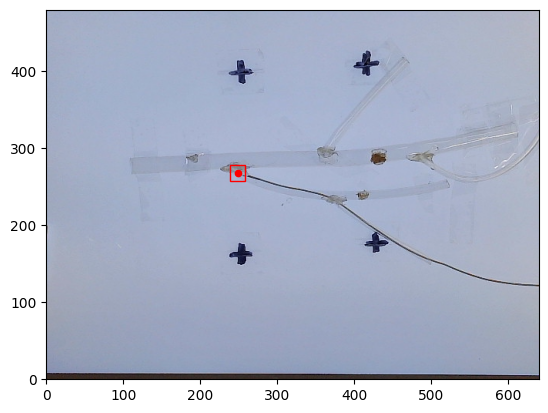

In [33]:
import os
import re
import json
from PIL import Image, ImageDraw

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import numpy as np

import matplotlib.patches as patches
import pandas as pd
from matplotlib.patches import Rectangle

# Define a custom sorting key function
def get_capture_number(filename):
    # print(filename)
    # Split the filename by "_" and get the last part as a string
    capture_part = filename.split("_")[-1]
    # Remove any file extensions (e.g., ".png" or ".json") and convert to an integer
    return int(capture_part.split(".")[0])

# Calculate bounding box - Defining region for the tip
def calculate_bounding_box(center_x, center_y, width, height):
  x_min = center_x - (width / 2)
  y_min = center_y - (height / 2)
  x_max = center_x - (width / 2)
  y_max = center_y - (height / 2)
  return x_min, y_min, x_max, y_max

# normalized bounding box center
def normalize_coords(x_shifted, y_shifted, img, bbox_h, bbox_w):
  height, width, channels = img.shape
  x_norm = x_shifted / width
  y_norm = y_shifted / height
  h_norm = bbox_h / height
  w_norm = bbox_w / width
  return x_norm, y_norm, h_norm, w_norm


# Specify the directory path where your JSON files are located
directory_path = '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/processed/data-aurora/pos6/'
# directory_path = 'drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/processed/data-aurora/pos6'

# Initialize an empty list to store the JSON data from each file
json_data_list = []
file_list = os.listdir(directory_path)
file_list = sorted(file_list, key=get_capture_number)

# Iterate over the files in the directory
for filename in file_list:
    basename, ext = os.path.splitext(filename)

    file_path = os.path.join(directory_path, basename+".json")
    with open(file_path, 'r') as file:
      lines = file.readlines()
      print("-------------")

      for line in lines:
        print(line)
        # Remove leading and trailing whitespace and split by spaces
        values = line.strip().split()

        # Now 'values' contains a list of values from the line
        # print(values)
        # cl_tip = int(values[0])
        # x_center = float(values[1])
        # y_center = float(values[1])
        # width = float(values[1])
        # height = float(values[1])
        x_shifted = json_data[0]["x_shifted"]
        y_shifted = json_data[0]["y_shifted"]
        z_shifted = json_data[0]["z_shifted"]

        x_raw = json_data[0]["x_raw"]
        y_raw = json_data[0]["y_raw"]
        z_raw = json_data[0]["z_raw"]

    image_path = os.path.join(directory_path, basename+".png")
    print(image_path)
    img = plt.imread(image_path)

    fig, ax = plt.subplots()
    ax.imshow(img)

    # Plot the red point
    ax.scatter(x_shifted, y_shifted, color='red', s=20)  # 's' controls the point size

    # Draw bounding box, values from YOLO version
    x_norm, y_norm, h_norm, w_norm = normalize_coords(x_shifted, y_shifted, img, 100, 100)
    w_bbox = 20
    h_bbox = 20
    x_bot_left = x_shifted - (w_bbox / 2)
    y_bot_left = y_shifted - (h_bbox / 2)

    ax.add_patch(Rectangle((x_bot_left, y_bot_left), w_bbox, h_bbox, edgecolor='r', facecolor='none'))
    plt.imshow(np.flipud(img), cmap='gray', origin='lower')
    plt.show()
    break;


# **Preparing** *Training Data*

## **1. Data Cleaning**


*   Clean data - remove some images that are redundant



In [ ]:
# Upon training, there are images that have wrong annotations, when I observe it,
# there are the images where the guidewire was not in the vessel anymore.
# These are unnecessary images that needs to be removed

In [ ]:
src_path = "/content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/raw"
src_dirs = ["pos5"]

for dir in src_dirs:
  print(src_path+"/"+dir)


/content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/raw/pos5


In [34]:
"""
REMOVE ALL THE IMAGES AND FILES with wrong annotation in the train.txt, or where guidewire not anymore in the vessel (as observed)
"""

fns = "[capture_158 capture_158 capture_159 capture_159 capture_160 capture_160 capture_161 capture_161 capture_162 capture_162 capture_163 capture_163 capture_164 capture_164 capture_165 capture_165 capture_166 capture_166 capture_167 capture_167 capture_168 capture_168 capture_169 capture_169 capture_170 capture_170 capture_171 capture_171 capture_172 capture_172 capture_173 capture_173 capture_174 capture_174 capture_175 capture_175 capture_176 capture_176 capture_177 capture_177 capture_178 capture_178 capture_179 capture_179 capture_180 capture_180 capture_181 capture_181 capture_182 capture_182 capture_183 capture_183 capture_184 capture_184 capture_185 capture_185 ]"
fns_list = fns[1:-1].split()
print(fns_list)

# List of filenames to remove
# filenames_to_remove = ['capture_158', 'capture_158', 'capture_159']

# Read the contents of the file
file_path = '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/train.txt'  # Update with your actual file path
with open(file_path, 'r') as file:
    lines = file.readlines()

# Filter the lines to remove the specified filenames
filtered_lines = [line for line in lines if all(filename not in line for filename in fns_list)]

# Write the filtered content back to the file
with open(file_path, 'w') as file:
    file.writelines(filtered_lines)


['capture_158', 'capture_158', 'capture_159', 'capture_159', 'capture_160', 'capture_160', 'capture_161', 'capture_161', 'capture_162', 'capture_162', 'capture_163', 'capture_163', 'capture_164', 'capture_164', 'capture_165', 'capture_165', 'capture_166', 'capture_166', 'capture_167', 'capture_167', 'capture_168', 'capture_168', 'capture_169', 'capture_169', 'capture_170', 'capture_170', 'capture_171', 'capture_171', 'capture_172', 'capture_172', 'capture_173', 'capture_173', 'capture_174', 'capture_174', 'capture_175', 'capture_175', 'capture_176', 'capture_176', 'capture_177', 'capture_177', 'capture_178', 'capture_178', 'capture_179', 'capture_179', 'capture_180', 'capture_180', 'capture_181', 'capture_181', 'capture_182', 'capture_182', 'capture_183', 'capture_183', 'capture_184', 'capture_184', 'capture_185', 'capture_185']


FileNotFoundError: ignored

In [ ]:
"""
MOVE ALL THE IMAGES AND FILES with wrong annotation, or where guidewire not anymore in the vessel (as observed)
"""

import os
import shutil

fns = "[capture_158 capture_158 capture_159 capture_159 capture_160 capture_160 capture_161 capture_161 capture_162 capture_162 capture_163 capture_163 capture_164 capture_164 capture_165 capture_165 capture_166 capture_166 capture_167 capture_167 capture_168 capture_168 capture_169 capture_169 capture_170 capture_170 capture_171 capture_171 capture_172 capture_172 capture_173 capture_173 capture_174 capture_174 capture_175 capture_175 capture_176 capture_176 capture_177 capture_177 capture_178 capture_178 capture_179 capture_179 capture_180 capture_180 capture_181 capture_181 capture_182 capture_182 capture_183 capture_183 capture_184 capture_184 capture_185 capture_185 ]"
fns_list = fns[1:-1].split()

# List of filenames to identify
target_filenames = fns_list

# Source directory (current directory in this example)
source_directory = '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/'

# Target directory to move the files
target_directory = '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data_wrong_annotation/'

# Iterate through the files in the source directory
for filename in os.listdir(source_directory):
    if any(target_filename in filename for target_filename in target_filenames):
        # Construct the full source and target paths
        source_path = os.path.join(source_directory, filename)
        target_path = os.path.join(target_directory, filename)

        # Move the file to the target directory
        shutil.move(source_path, target_path)
        print(f'Moved {filename} to {target_directory}')

print('Files moved successfully.')

Moved pos6_capture_158.txt to /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data_wrong_annotation/
Moved pos6_capture_158.png to /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data_wrong_annotation/
Moved pos6_capture_159.txt to /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data_wrong_annotation/
Moved pos6_capture_159.png to /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data_wrong_annotation/
Moved pos6_capture_160.txt to /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data_wrong_annotation/
Moved pos6_capture_160.png to /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data_wrong_annotation/
Moved pos6_capture_161.txt to /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data_wrong_annotation/

## **1. Label Data in YOLO Format**


*   Augment Images
*   Convert annotation to YOLO format
*   Save image and text file to labelled-data



In [ ]:
import os
os.chdir('/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom')

In [40]:
"""
FOR MULTIPLE DIRECTORIES
"""

import os

# Define a custom sorting key function
def get_capture_number(filename):
    # Split the filename by "_" and get the last part as a string
    capture_part = filename.split("_")[-1]
    # Remove any file extensions (e.g., ".png" or ".json") and convert to an integer
    return int(capture_part.split(".")[0])

directory_path = '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/processed/data-aurora/'

# Iterate through the folders in the specified directory
for folder in os.listdir(directory_path):
    if os.path.isdir(os.path.join(directory_path, folder)) and folder.startswith("pos"):
        print("Folder starting with 'pos':", folder)
        sub_path =

Folder starting with 'pos': pos6
Folder starting with 'pos': pos1
Folder starting with 'pos': pos8
Folder starting with 'pos': pos12
Folder starting with 'pos': pos9
Folder starting with 'pos': pos7
Folder starting with 'pos': pos11
Folder starting with 'pos': pos2
Folder starting with 'pos': pos5
Folder starting with 'pos': pos10
Folder starting with 'pos': pos4
Folder starting with 'pos': pos3


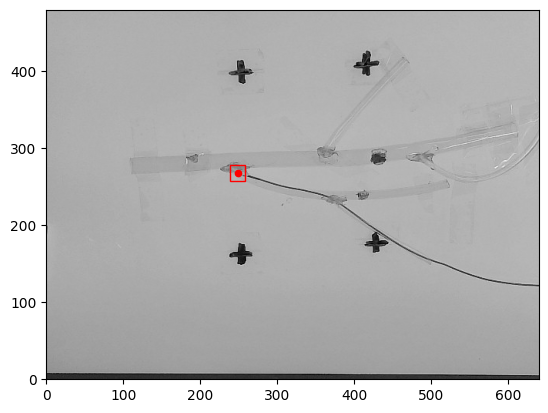

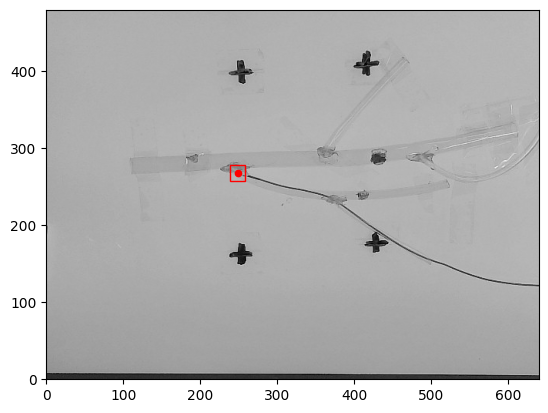

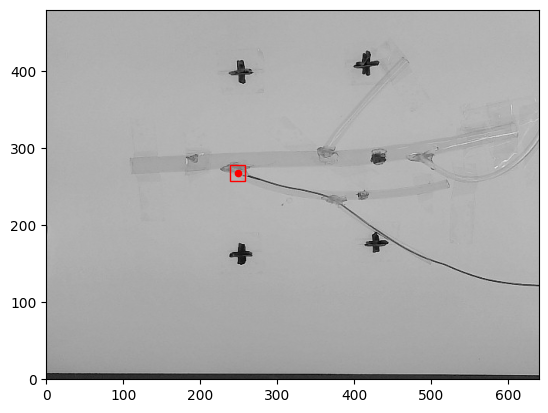

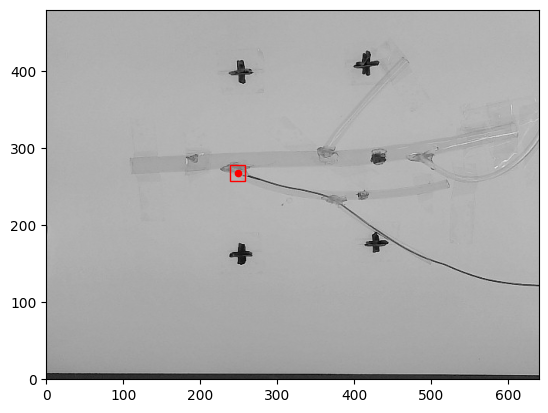

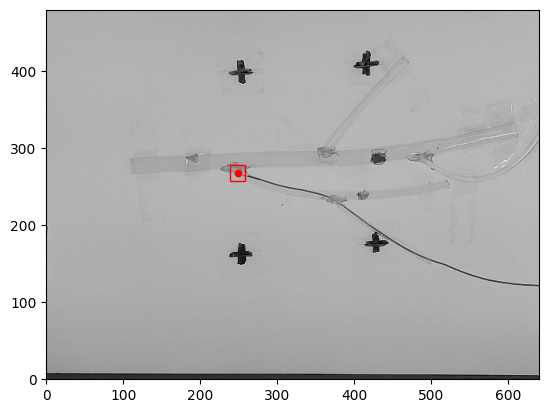

...

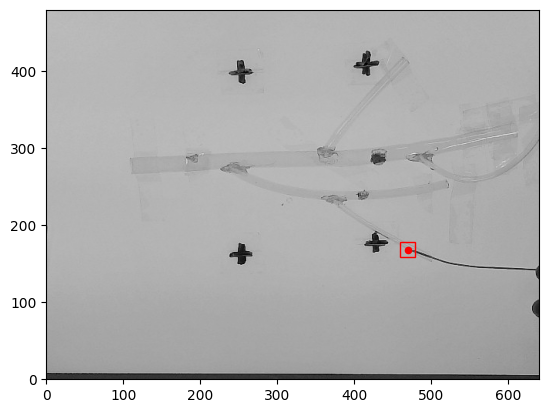

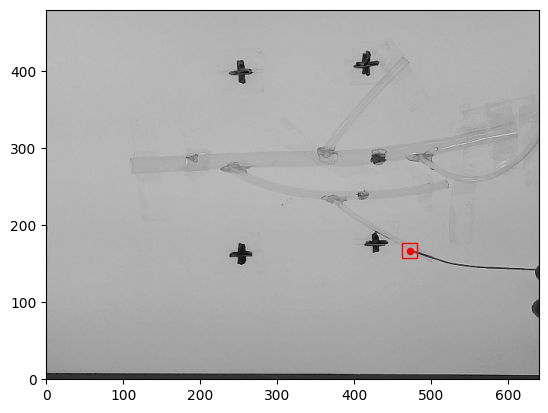

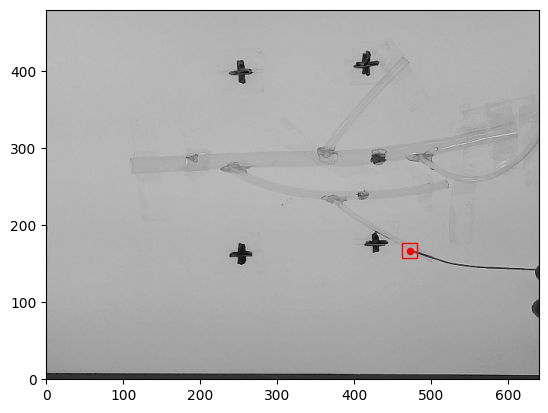

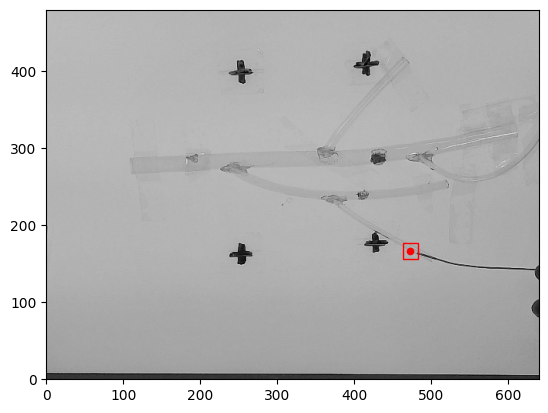

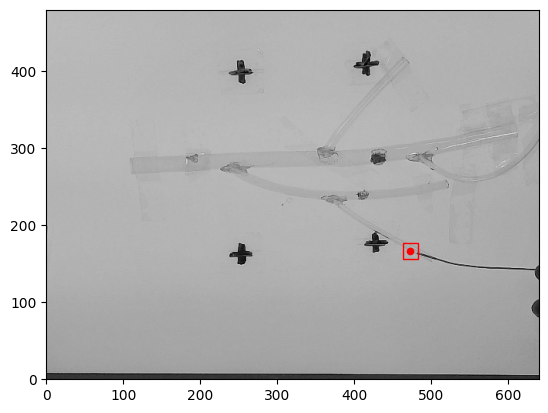

In [37]:
"""
FOR INDIVIDUAL DIRECTORY
"""

# [class centerx centery objwidth objheight] - Start with one folder first

import os
import re
import json
from PIL import Image, ImageDraw

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import numpy as np

import matplotlib.patches as patches
import pandas as pd
from matplotlib.patches import Rectangle
import albumentations as A
# from PIL import Image

# Simple augmentation pipeline
transform = A.Compose([
    A.ToGray(p=1.0)
])
# visualize(augmented_image)

# Define a custom sorting key function
def get_capture_number(filename):
    # Split the filename by "_" and get the last part as a string
    capture_part = filename.split("_")[-1]
    # Remove any file extensions (e.g., ".png" or ".json") and convert to an integer
    return int(capture_part.split(".")[0])

# Calculate bounding box - Defining region for the tip
def calculate_bounding_box(center_x, center_y, width, height):
  x_min = center_x - (width / 2)
  y_min = center_y - (height / 2)
  x_max = center_x - (width / 2)
  y_max = center_y - (height / 2)
  return x_min, y_min, x_max, y_max

# normalized bounding box center
def normalize_coords(x_shifted, y_shifted, img, bbox_h, bbox_w):
  height, width, channels = img.shape
  # print(height)
  # print(width)
  x_norm = x_shifted / width
  y_norm = y_shifted / height
  h_norm = bbox_h / height
  w_norm = bbox_w / width
  return x_norm, y_norm, h_norm, w_norm


# Specify the directory path where your JSON files are located
directory_path = '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/processed/data-aurora/pos6'
# directory_path_target = '/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled-data'
directory_path_target = '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/'


# Initialize an empty list to store the JSON data from each file
json_data_list = []
file_list = os.listdir(directory_path)
file_list = sorted(file_list, key=get_capture_number)

# # for testing only -------------
# # Numbers to match
# # numbers_to_match = [163, 182, 177, 165, 168, 170, 176, 173, 160, 166, 167]
# # numbers_to_match = [183,162,174,180,161,175,184,181]
# numbers_to_match = [164,171,169]

# # Create a regular expression pattern
# pattern = r'.*(' + '|'.join(str(num) for num in numbers_to_match) + r').*'

# # Filter the file list using the regular expression pattern
# filtered_files = [filename for filename in file_list if re.match(pattern, filename)]

# file_list = sorted(filtered_files, key=get_capture_number)

# # ------------------------------


# Iterate over the files in the directory
for filename in file_list:
    basename, ext = os.path.splitext(filename)

    file_path = os.path.join(directory_path, basename+".json")
    with open(file_path, 'r') as json_file:
      json_data = json.load(json_file)
      val_toolName = json_data[0]["toolName"]
      x_shifted = json_data[0]["x_shifted"]
      y_shifted = json_data[0]["y_shifted"]
      z_shifted = json_data[0]["z_shifted"]

      x_raw = json_data[0]["x_raw"]
      y_raw = json_data[0]["y_raw"]
      z_raw = json_data[0]["z_raw"]

    image_path = os.path.join(directory_path, basename+".png")
    # print(image_path)
    img = plt.imread(image_path)
    fig, ax = plt.subplots()

    # augment image to gray scale
    augmented_image = transform(image=img)['image']
    # augmented_image = img
    ax.imshow(augmented_image)

    # Plot the red point
    ax.scatter(x_shifted, y_shifted, color='red', s=20)  # 's' controls the point size

    # Draw bounding box, values from YOLO version
    x_norm, y_norm, h_norm, w_norm = normalize_coords(x_shifted, y_shifted, img, 20, 20)
    # test
    # Check if x_norm and y_norm are within [0, 1]
    is_x_norm_valid = 0 <= x_norm <= 1
    is_y_norm_valid = 0 <= y_norm <= 1
    message = filename
    if not is_x_norm_valid:
        message += " invalid x"
    if not is_y_norm_valid:
        if not is_x_norm_valid:  # Append space if x is also invalid
            message += " "
        else:  # Append "invalid y" directly if x is valid
            message += "invalid y"

    # Print the message
    if not is_x_norm_valid or not is_y_norm_valid:
      print(message)

    # filename invalid x invalid y


    # print("-----")
    # print(x_norm)
    # print(y_norm)
    # print(h_norm)
    # print(w_norm)

    w_bbox = 20
    h_bbox = 20
    # x_bot_left = x_shifted - (w_bbox / 2) # x_min
    # y_bot_left = y_shifted - (h_bbox / 2) # y_max
    x_bot_left = x_shifted - (w_bbox / 2) # x_min
    y_bot_left = y_shifted - (h_bbox / 2) # y_max
    ax.add_patch(Rectangle((x_bot_left, y_bot_left), w_bbox, h_bbox, edgecolor='r', facecolor='none'))

    plt.imshow(np.flipud(augmented_image), cmap='gray', origin='lower')


    # change the file name
    output_filename = os.path.basename(directory_path)+"_"+basename

    # save bounding box in a text file
    cl_tip = 0
    # formatted_values = f"{cl_tip} {round(x_norm,4)} {round(y_norm,4)} {round(w_norm,4)} {round(h_norm,4)}"
    formatted_values = f"{cl_tip} {x_norm} {y_norm} {w_norm} {h_norm}"

    if not os.path.exists(os.path.join(directory_path_target, output_filename+".txt")):
      with open(os.path.join(directory_path_target, output_filename+".txt"), "x") as file:
          file.write(formatted_values)

    # save new grayed image to labelled-data
    plt.imsave(os.path.join(directory_path_target, output_filename+".png"),augmented_image, origin='lower')
    plt.show()
    # break;




In [ ]:
import re

# List of filenames
file_list = ['file163.txt', 'file182.jpg', 'file177.doc', 'file165.txt', 'file168.pdf',
             'file170.txt', 'file176.png', 'file173.docx', 'file160.pdf', 'file166.jpg',
             'file167.txt', 'file999.png']

# Numbers to match
numbers_to_match = [163, 182, 177, 165, 168, 170, 176, 173, 160, 166, 167]

# Create a regular expression pattern
pattern = r'.*(' + '|'.join(str(num) for num in numbers_to_match) + r').*'

# Filter the file list using the regular expression pattern
filtered_files = [filename for filename in file_list if re.match(pattern, filename)]

# Print the filtered filenames
print('Filtered File List:')
print(filtered_files)

Filtered File List:
['file163.txt', 'file182.jpg', 'file177.doc', 'file165.txt', 'file168.pdf', 'file170.txt', 'file176.png', 'file173.docx', 'file160.pdf', 'file166.jpg', 'file167.txt']


## **2. Split the Data into Train and Test**

In [38]:
import os

"""
Start of:
Setting up full path to directory with downloaded images
"""

# Full or absolute path to the folder with images
# Find it with Py file getting-full-path.py
# Pay attention! If you're using Windows, yours path might looks like:
# r'C:\Users\my_name\OIDv4_ToolKit\OID\Dataset\train\Car_Bicycle_wheel_Bus'
# or:
# 'C:\\Users\\my_name\\OIDv4_ToolKit\\OID\\Dataset\\train\Car_Bicycle_wheel_Bus'

full_path_to_images = \
    '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data'

"""
End of:
Setting up full path to directory with downloaded images
"""

# Check point
# Getting the current directory
print(os.getcwd())

# Changing the current directory
# to one with images
os.chdir(full_path_to_images)

# Check point
# Getting the current directory
print(os.getcwd())


/
/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data


In [ ]:
import os

# Creating files train.txt and test.txt
# for training in Darknet framework
#
# Algorithm:
# Setting up full paths --> List of paths -->
# --> Extracting 15% of paths to save into test.txt file -->
# --> Writing paths into train and test txt files
#
# Result:
# Files train.txt and test.txt with full paths to images



"""
Start of:
Getting list of full paths to downloaded images
"""

# Defining list to write paths in
p = []

# Using os.walk for going through all directories
# and files in them from the current directory
# Fullstop in os.walk('.') means the current directory
for current_dir, dirs, files in os.walk('.'):
    # Going through all files
    for f in files:
        # Checking if filename ends with '.jpg'
        if f.endswith('.png'):
            # Preparing path to save into train.txt file
            # Pay attention!
            # If you're using Windows, it might need to change
            # this: + '/' +
            # to this: + '\' +
            # or to this: + '\\' +
            path_to_save_into_txt_files = full_path_to_images + '/' + f

            # Appending the line into the list
            # We use here '\n' to move to the next line
            # when writing lines into txt files
            p.append(path_to_save_into_txt_files + '\n')


# Slicing first 15% of elements from the list
# to write into the test.txt file
p_test = p[:int(len(p) * 0.15)]

print(p_test)

# Deleting from initial list first 15% of elements
p = p[int(len(p) * 0.15):]

"""
End of:
Getting list of full paths to downloaded images
"""


"""
Start of:
Creating train.txt and test.txt files
"""

# Creating file train.txt and writing 85% of lines in it
with open('train.txt', 'w') as train_txt:
    # Going through all elements of the list
    for e in p:
        # Writing current path at the end of the file
        train_txt.write(e)

# Creating file test.txt and writing 15% of lines in it
with open('test.txt', 'w') as test_txt:
    # Going through all elements of the list
    for e in p_test:
        # Writing current path at the end of the file
        test_txt.write(e)

"""
End of:
Creating train.txt and test.txt files
"""


['/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_1.png\n', '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_2.png\n', '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_3.png\n', '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_4.png\n', '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_5.png\n', '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_6.png\n', '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_7.png\n', '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_8.png\n', '/content/drive/MyDrive/ColabNotebooks/yolo-obj

'\nEnd of:\nCreating train.txt and test.txt files\n'

## **3. Create Files Data and Name**

In [ ]:
# creating file with full directory path
# !python data/labelled/labelled-data/getting-full-path.py
# full labelled-data directory: /content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled-data




"""
Course:  Training YOLO v3 for Objects Detection with Custom Data

Section-3
Labelling new Dataset in YOLO format
File: creating-files-data-and-name.py
"""


# Creating files labelled_data.data and classes.names
# for training in Darknet framework
#
# Algorithm:
# Setting up full paths --> Reading file classes.txt -->
# --> Creating file classes.names -->
# --> Creating file labelled_data.data
#
# Result:
# Files classes.names and labelled_data.data needed to train
# in Darknet framework


"""
Start of:
Setting up full path to directory with labelled images
"""

# Full or absolute path to the folder with images
# Find it with Py file getting-full-path.py
# Pay attention! If you're using Windows, yours path might looks like:
# r'C:\Users\my_name\Downloads\video-to-annotate'
# or:
# 'C:\\Users\\my_name\\Downloads\\video-to-annotate'
# full_path_to_images =  'drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled_data'

"""
End of:
Setting up full path to directory with labelled images
"""


"""
Start of:
Creating file classes.names
"""

# Defining counter for classes
c = 0

# Creating file classes.names from existing one classes.txt
# Pay attention! If you're using Windows, it might need to change
# this: + '/' +
# to this: + '\' +
# or to this: + '\\' +
with open(full_path_to_images + '/' + 'classes.names', 'w') as names, \
     open(full_path_to_images + '/' + 'classes.txt', 'r') as txt:

    # Going through all lines in txt file and writing them into names file
    for line in txt:
        names.write(line)  # Copying all info from file txt to names

        # Increasing counter
        c += 1

"""
End of:
Creating file classes.names
"""


"""
Start of:
Creating file labelled_data.data
"""

# Creating file labelled_data.data
# Pay attention! If you're using Windows, it might need to change
# this: + '/' +
# to this: + '\' +
# or to this: + '\\' +
with open(full_path_to_images + '/' + 'labelled_data.data', 'w') as data:
    # Writing needed 5 lines
    # Number of classes
    # By using '\n' we move to the next line
    data.write('classes = ' + str(c) + '\n')

    # Location of the train.txt file
    data.write('train = ' + full_path_to_images + '/' + 'train.txt' + '\n')

    # Location of the test.txt file
    data.write('valid = ' + full_path_to_images + '/' + 'test.txt' + '\n')

    if not os.path.exists(full_path_to_images + '/' + 'classes.names'):
      with open(full_path_to_images + '/' + 'classes.names', "x") as file:
        # Location of the classes.names file
        file.write('names = ' + full_path_to_images + '/' + 'classes.names' + '\n')

    # Location where to save weights
    data.write('backup = backup')

"""
End of:
Creating file labelled_data.data
"""


'\nEnd of:\nCreating file labelled_data.data\n'

/content


# **Training on Darknet**


*   How to install and compile Darknet Framework in Google Colab



In [ ]:
!apt update
#!apt upgrade -y
!uname -m && cat /etc/*release
!gcc --version
!uname -r

Hit:1 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:2 http://security.ubuntu.com/ubuntu jammy-security InRelease [110 kB]
Get:3 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Get:4 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [119 kB]
Get:5 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Hit:6 https://ppa.launchpadcontent.net/c2d4u.team/c2d4u4.0+/ubuntu jammy InRelease
Get:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [109 kB]
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:10 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [498 kB]
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:12 http://security.ubuntu.com/ubuntu jammy-security/main amd64 Packages [966 kB]
Get:13 http://security.ubuntu.co

In [ ]:
!nvidia-smi

Fri Sep 15 06:52:17 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   65C    P8    11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import os
os.chdir('/content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
cd MyDrive/Colab \Notebooks/yolo-object-detection-custom


/content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom


In [ ]:
#%rm -r darknet
!git clone https://github.com/AlexeyAB/darknet/
%cd darknet/
# /content/darknet
#/content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/darknet

Cloning into 'darknet'...
remote: Enumerating objects: 15750, done.
remote: Counting objects: 100% (213/213), done.
remote: Compressing objects: 100% (126/126), done.
remote: Total 15750 (delta 103), reused 155 (delta 85), pack-reused 15537
Receiving objects: 100% (15750/15750), 14.66 MiB | 9.64 MiB/s, done.
Resolving deltas: 100% (10532/10532), done.
Updating files: 100% (2063/2063), done.
/content/drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/darknet


In [2]:
cd /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/darknet

/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/darknet


In [5]:
!make

chmod +x *.sh
g++ -std=c++11 -std=c++11 -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -rdynamic -Ofast -DOPENCV -c ./src/image_opencv.cpp -o obj/image_opencv.o
./src/image_opencv.cpp: In function ‘void draw_detections_cv_v3(void**, detection*, int, float, char**, image**, int, int)’:
./src/image_opencv.cpp:946:23: warning: variable ‘rgb’ set but not used []8;;https://gcc.gnu.org/onlinedocs/gcc/Warning-Options.html#index-Wunused-but-set-variable-Wunused-but-set-variable]8;;]
  946 |                 float rgb[3];
      |                       ^~~
./src/image_opencv.cpp: In function ‘void cv_draw_object(image, float*, int, int, int*, float*, int*, int, char**)’:
./src/image_opencv.cpp:1444:14: warning: unused variable ‘buff’ []8;;https://gcc.gnu.org/onlinedocs/gcc/Warning-Options.html#index-Wunused-variable-Wunused-variable]8;;]
 1444 |         c

In [ ]:
!./darknet

usage: ./darknet <function>


In [ ]:
# !chmod +x darknet

!./darknet detector demo cfg/coco.data cfg/yolov3.cfg weights/yolov3.weights -thresh 0.85 -dont_show data/test-video.mp4 -out_filename result.avi

 CUDA-version: 11080 (12000), GPU count: 1  
 OpenCV version: 4.5.4
^C


In [12]:
!./darknet detect

 GPU isn't used 
 OpenCV version: 4.5.4
^C


In [1]:

cd /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/darknet/

/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/darknet


# **Training on Custom Dataset**

In [2]:
!chmod +x darknet
!./darknet detector train cfg/labelled_data.data cfg/yolov3_custom_train.cfg weights/yolov3.weights -dont_show -clear

Streaming output truncated to the last 5000 lines.
 total_bbox = 93448, rewritten_bbox = 0.000000 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 82 Avg (IOU: 0.000000), count: 1, class_loss = 0.000000, iou_loss = 0.000000, total_loss = 0.000000 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 94 Avg (IOU: 0.000000), count: 1, class_loss = 0.000000, iou_loss = 0.000000, total_loss = 0.000000 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 106 Avg (IOU: 0.513310), count: 3, class_loss = 0.779023, iou_loss = 0.577490, total_loss = 1.356513 
 total_bbox = 93451, rewritten_bbox = 0.000000 % 
1626/2000: loss=0.4 hours left=1.1
 1626: 0.432801, 0.322991 avg loss, 0.000100 rate, 14.358175 seconds, 104064 images, 1.086753 hours left
Loaded: 0.000088 seconds
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 82 Avg (IOU: 0.000000), count: 1, class_loss = 0.000000, iou_loss = 0.000000, total_loss = 0.000000 
v3 (mse lo

183,162,174,180,161,175,184,181
164,171,169

# **Testing on Custom Dataset**

In [33]:
!ls -ltrh predictions.jpg

-rw------- 1 root root 691 Sep 22 20:13 predictions.jpg


In [35]:
ls -ltrh

���� JFIF      �� � 


		
%# , #&')*)-0-(0%()(



(((((((((((((((((((((((((((((((((((((((((((((((((((��  
 
" ���          	
   } !1AQa"q2���#B��R��$3br�	
%&'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz�������������������������������������������������������������������������       	
  w !1AQaq"2�B����	#3R�br�
$4�%�&'()*56789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz��������������������������������������������������������������������������   ? �R�(��

In [ ]:
!chmod +x darknet
# !./darknet detector test cfg/labelled_data.data cfg/yolov3_custom_test.cfg weights/yolov3.weights data/test-image.jpg
!./darknet detector test cfg/labelled_data.data cfg/yolov3_custom_test.cfg weights/yolov3.weights data/pos6_capture_40.png -thresh 0.0

 GPU isn't used 
 OpenCV version: 4.5.4


In [26]:

!date

Fri Sep 22 07:57:51 PM UTC 2023


In [23]:
!ls -ltrh

total 16M
-rw------- 1 root root  67K Sep 15 17:05 README.md
-rw------- 1 root root  515 Sep 15 17:05 LICENSE
-rw------- 1 root root  834 Sep 15 17:05 Dockerfile.gpu
-rw------- 1 root root  777 Sep 15 17:05 Dockerfile.cpu
-rw------- 1 root root 1.4K Sep 15 17:05 DarknetConfig.cmake.in
-rw------- 1 root root  29K Sep 15 17:05 CMakeLists.txt
-rw------- 1 root root  42K Sep 15 17:05 build.ps1
drwx------ 2 root root 4.0K Sep 15 17:05 build
drwx------ 2 root root 4.0K Sep 15 17:05 3rdparty
drwx------ 4 root root 4.0K Sep 15 17:05 cfg
drwx------ 4 root root 4.0K Sep 15 17:05 data
-rw------- 1 root root 7.9K Sep 15 17:05 darknet_video.py
-rw------- 1 root root  11K Sep 15 17:05 darknet.py
-rw------- 1 root root 9.4K Sep 15 17:05 darknet_images.py
drwx------ 3 root root 4.0K Sep 15 17:05 cmake
drwx------ 2 root root 4.0K Sep 15 17:05 scripts
drwx------ 2 root root 4.0K Sep 15 17:05 results
-rw------- 1 root root  712 Sep 15 17:05 package.xml
-rw------- 1 root root  159 Sep 15 17:05 net_cam_v4.

In [8]:
!chmod +x darknet
!./darknet detector demo cfg/labelled_data.data cfg/yolov3_custom_test.cfg backup/yolov3_custom_train_final.weights data/pos3_vid.mp4 data/pos3_output.avi -dont_show

 GPU isn't used 
 OpenCV version: 4.5.4
Demo
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5,  wt = 0, wn = 0, outputs: 104 x 104 x 128 0.001 BF
   9 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
  10 conv    128       3 x 3/ 1    104 x 10

## ***Data Augmentation of image and annotation***



*   List augmentation pipeline which is possible for both images and annotations
*   Distorting might not be applicable



In [ ]:
# file_path = '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/train.txt'

# # Open the file in read mode
# with open(file_path, 'r') as file:
#     # Read and print the contents of the file
#     file_contents = file.read()
#     print(file_contents)

!chmod +x /content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/data/labelled/labelled_data/train.txt


In [ ]:
# Load the .data file and extract the file path
def extract_file_path(data_file_path):
    file_path = None
    with open(data_file_path, 'r') as data_file:
        print(data_file_path)
        for line in data_file:
            if line.startswith('train ='):
                file_path = line.split('=')[1].strip()
                break
    return file_path

# Specify the .data file path
data_file_path = '/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/darknet/cfg/labelled_data.data'  # Update with your actual .data file path

# Extract the file path
file_path = extract_file_path(data_file_path)

# Open the file using the extracted file path
if file_path:
    with open(file_path, 'r') as file:
        file_contents = file.read()
        print('Contents of the file:')
        print(file_contents)
else:
    print('File path not found in the .data file.')


/content/drive/MyDrive/ColabNotebooks/yolo-object-detection-custom/darknet/cfg/labelled_data.data
Contents of the file:
drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_28.png
drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_29.png
drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_30.png
drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_31.png
drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_32.png
drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_33.png
drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_34.png
drive/MyDrive/Colab Notebooks/yolo-object-detection-custom/data/labelled/labelled_data/pos6_capture_35.png
drive/MyDrive/Colab Note